<a href="https://colab.research.google.com/github/tanzzz07/xxxx/blob/main/dva_project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [9]:
import pandas as pd

In [10]:
df  =  pd.read_csv('data.csv', encoding='latin-1')

In [11]:
df.shape

(541909, 8)

In [12]:
df.sample(5)

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
71189,542112,20616,CHERRY BLOSSOM PASSPORT COVER,1,1/25/2011 13:55,2.10,13168.0,United Kingdom
222875,556459,85035A,GARDENIA 3 WICK MORRIS BOXED CANDLE,2,6/10/2011 17:25,8.29,NaN,United Kingdom
202724,554494,84879,ASSORTED COLOUR BIRD ORNAMENT,16,5/24/2011 14:00,1.69,16327.0,United Kingdom
47749,540418,20616,CHERRY BLOSSOM PASSPORT COVER,1,1/7/2011 11:04,1.66,NaN,United Kingdom
272122,560732,22556,PLASTERS IN TIN CIRCUS PARADE,5,7/20/2011 14:55,1.65,14056.0,United Kingdom


In [13]:
df['TotalPrice'] = df['Quantity'] * df['UnitPrice']
df['InvoiceDate'] = pd.to_datetime(df['InvoiceDate'])
df['InvoiceMonth'] = df['InvoiceDate'].dt.month
df['DayOfWeek'] = df['InvoiceDate'].dt.day_name()


In [14]:
df.sample(5)

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,TotalPrice,InvoiceMonth,DayOfWeek
364267,568654,22927,GREEN GIANT GARDEN THERMOMETER,2,2011-09-28 12:20:00,5.95,14911.0,EIRE,11.90,9,Wednesday
349278,567484,21918,SET 12 KIDS COLOUR CHALK STICKS,24,2011-09-20 13:52:00,0.42,17340.0,United Kingdom,10.08,9,Tuesday
31558,538995,48184,DOORMAT ENGLISH ROSE,10,2010-12-15 12:05:00,6.75,13458.0,United Kingdom,67.50,12,Wednesday
2172,536566,22771,CLEAR DRAWER KNOB ACRYLIC EDWARDIAN,10,2010-12-01 15:21:00,1.25,16928.0,United Kingdom,12.50,12,Wednesday
425502,573328,46000M,POLYESTER FILLER PAD 45x45cm,12,2011-10-30 11:09:00,1.55,16601.0,United Kingdom,18.60,10,Sunday


# Task
Perform exploratory data analysis on the provided sales data to visualize overall sales and purchasing behavior. The analysis should include visualizations for monthly revenue trends, top-selling products, most frequent customers, sales by country, purchases by day of week/hour, and the correlation between quantity, price, and revenue. Use Matplotlib, Seaborn, or Plotly for visualizations.

## Monthly revenue trends

### Subtask:
Aggregate the data by month and calculate the total revenue for each month. Visualize the monthly revenue using a line chart to show trends over time.


**Reasoning**:
Aggregate the data by month, calculate the total revenue for each month, sort the results, and plot the monthly revenue trends using a line chart with appropriate labels and title.



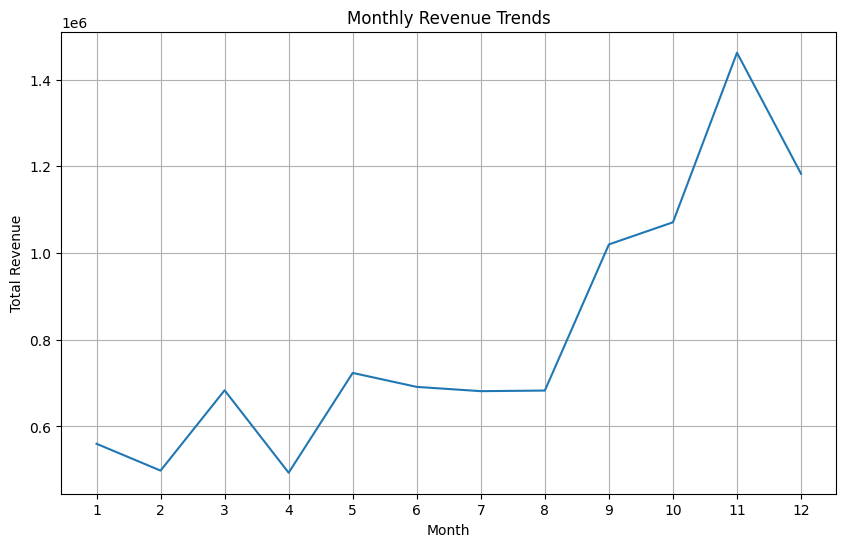

In [15]:
monthly_revenue = df.groupby('InvoiceMonth')['TotalPrice'].sum().reset_index()
monthly_revenue = monthly_revenue.sort_values('InvoiceMonth')

import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.plot(monthly_revenue['InvoiceMonth'], monthly_revenue['TotalPrice'])
plt.title('Monthly Revenue Trends')
plt.xlabel('Month')
plt.ylabel('Total Revenue')
plt.xticks(monthly_revenue['InvoiceMonth'])
plt.grid(True)
plt.show()

## Top-selling products

### Subtask:
Aggregate the data by product and calculate the total sales for each product. Visualize the top N best-selling products using a bar chart.


**Reasoning**:
Aggregate the data by product, calculate the total sales, sort, select the top N, and create a bar chart to visualize the top-selling products.



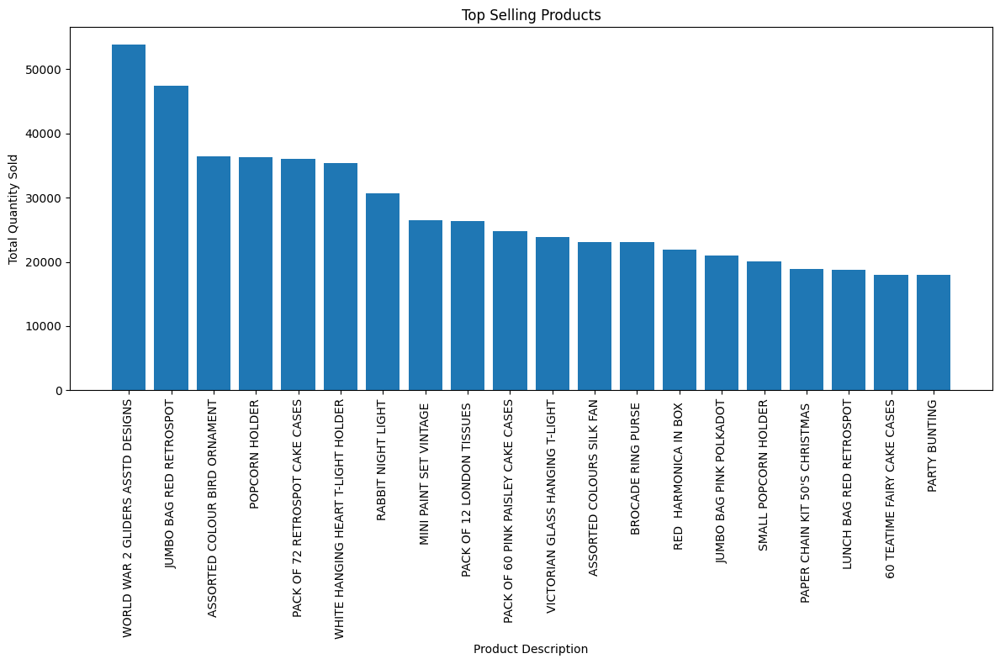

In [16]:
product_sales = df.groupby('Description')['Quantity'].sum().reset_index()
product_sales_sorted = product_sales.sort_values('Quantity', ascending=False)
top_n = 20
top_selling_products = product_sales_sorted.head(top_n)

import matplotlib.pyplot as plt

plt.figure(figsize=(12, 8))
plt.bar(top_selling_products['Description'], top_selling_products['Quantity'])
plt.title('Top Selling Products')
plt.xlabel('Product Description')
plt.ylabel('Total Quantity Sold')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

## Most frequent customers

### Subtask:
Aggregate the data by customer and count the number of purchases for each customer. Visualize the top N most frequent customers using a bar chart.


**Reasoning**:
Aggregate the data by customer to count the number of purchases and then visualize the top N most frequent customers using a bar chart.



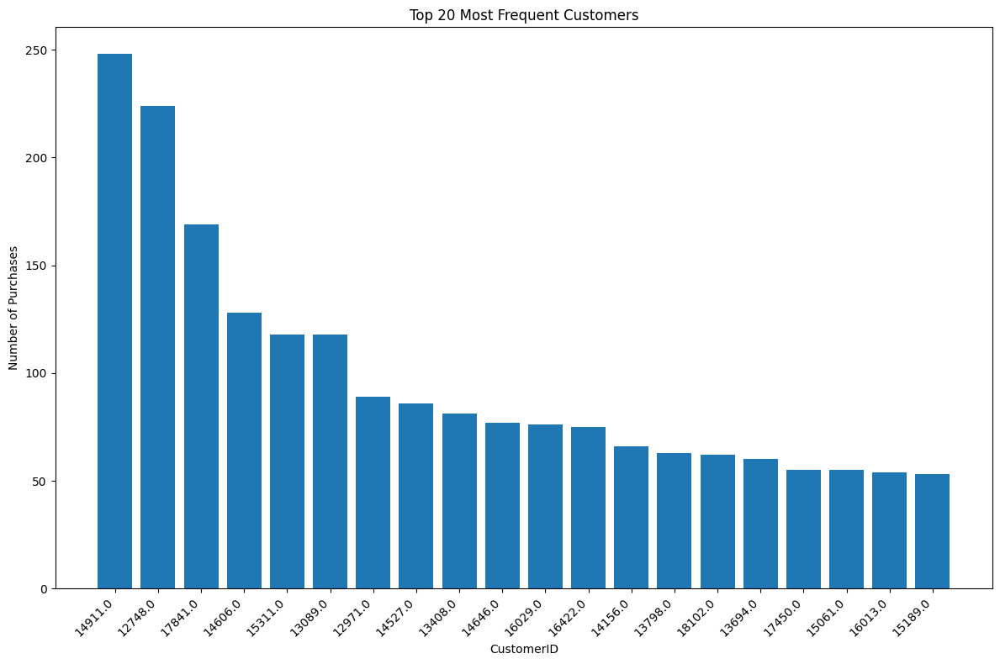

In [17]:
customer_purchases = df.groupby('CustomerID')['InvoiceNo'].nunique().reset_index()
customer_purchases_sorted = customer_purchases.sort_values('InvoiceNo', ascending=False)
top_n = 20
top_customers = customer_purchases_sorted.head(top_n)

import matplotlib.pyplot as plt

plt.figure(figsize=(12, 8))
plt.bar(top_customers['CustomerID'].astype(str), top_customers['InvoiceNo'])
plt.title(f'Top {top_n} Most Frequent Customers')
plt.xlabel('CustomerID')
plt.ylabel('Number of Purchases')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

## Sales by country

### Subtask:
Aggregate the data by country and calculate the total sales for each country. Visualize the sales by country using a choropleth map.


**Reasoning**:
Filter the data, aggregate by country, calculate total sales, and then create a choropleth map to visualize sales by country.



In [18]:
filtered_df = df.dropna(subset=['CustomerID']).copy()
filtered_df = filtered_df[filtered_df['TotalPrice'] > 0]

country_sales = filtered_df.groupby('Country')['TotalPrice'].sum().reset_index()

import plotly.express as px

fig = px.choropleth(country_sales,
                    locations="Country",
                    locationmode='country names',
                    color="TotalPrice",
                    title='Total Sales by Country')
fig.show()

## Purchases by day of week/hour

### Subtask:
Aggregate the data by day of the week and hour of the day and count the number of purchases. Visualize the purchase frequency using a heatmap.


**Reasoning**:
Extract the hour from the InvoiceDate column and store it in a new column named InvoiceHour. Then group the filtered DataFrame by DayOfWeek and InvoiceHour, count the number of unique InvoiceNo values for each group, reset the index, and name the count column 'PurchaseCount'. After that, pivot the resulting DataFrame so that DayOfWeek becomes the index, InvoiceHour becomes the columns, and 'PurchaseCount' fills the values. Finally, reindex the pivoted DataFrame so that the rows (days of the week) are in the correct order (Monday to Sunday).



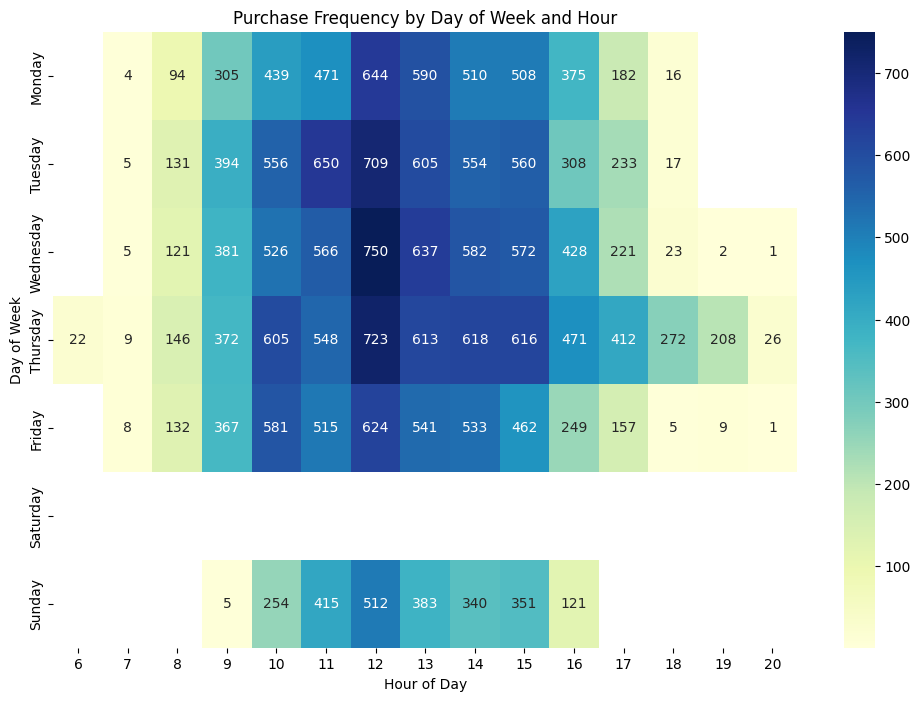

In [20]:
df['InvoiceHour'] = df['InvoiceDate'].dt.hour

purchase_frequency = df.groupby(['DayOfWeek', 'InvoiceHour'])['InvoiceNo'].nunique().reset_index(name='PurchaseCount')

purchase_frequency_pivot = purchase_frequency.pivot(index='DayOfWeek', columns='InvoiceHour', values='PurchaseCount')

day_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
purchase_frequency_pivot = purchase_frequency_pivot.reindex(day_order)

import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 8))
sns.heatmap(purchase_frequency_pivot, cmap='YlGnBu', annot=True, fmt='.0f')
plt.title('Purchase Frequency by Day of Week and Hour')
plt.xlabel('Hour of Day')
plt.ylabel('Day of Week')
plt.show()

**Reasoning**:
The heatmap failed because the data in the pivot table contains NaN values (which are floats), and the format code 'd' is for integers. I will use the format code '.0f' to display the annotations as integers with no decimal places, which can handle both integer and float values.



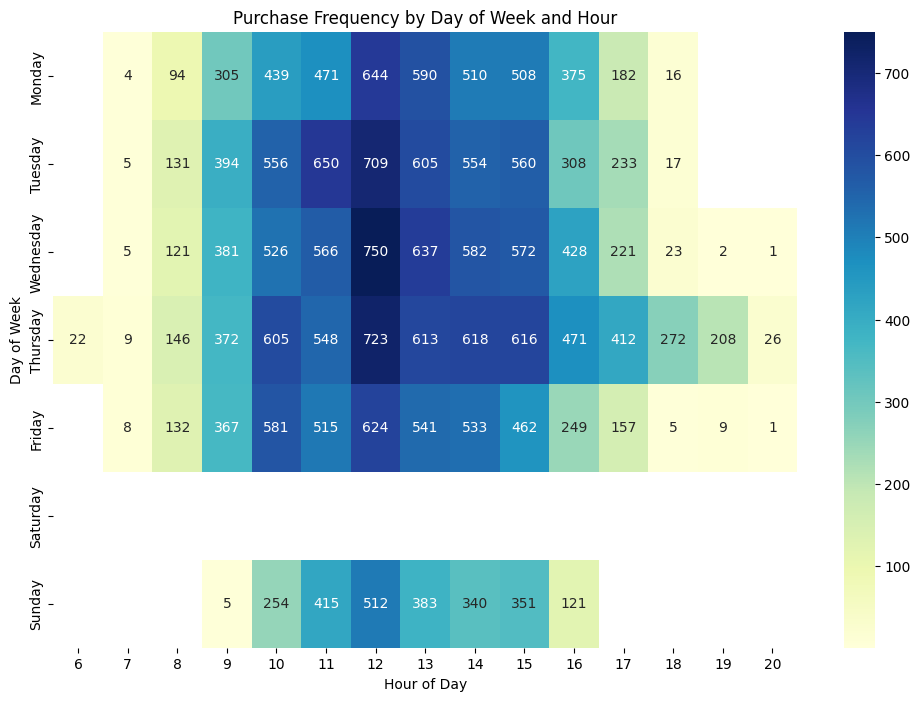

In [21]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 8))
sns.heatmap(purchase_frequency_pivot, cmap='YlGnBu', annot=True, fmt='.0f')
plt.title('Purchase Frequency by Day of Week and Hour')
plt.xlabel('Hour of Day')
plt.ylabel('Day of Week')
plt.show()

## Correlation between quantity, price, revenue

### Subtask:
Analyze the correlation between quantity, unit price, and total revenue using scatter plots.


**Reasoning**:
Generate scatter plots to visualize the relationship between Quantity, UnitPrice, and TotalPrice, as requested in the instructions.



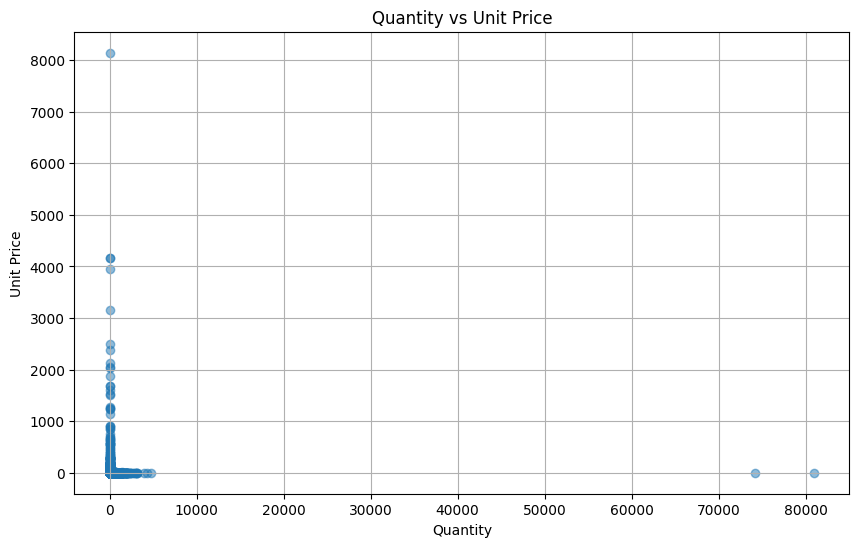

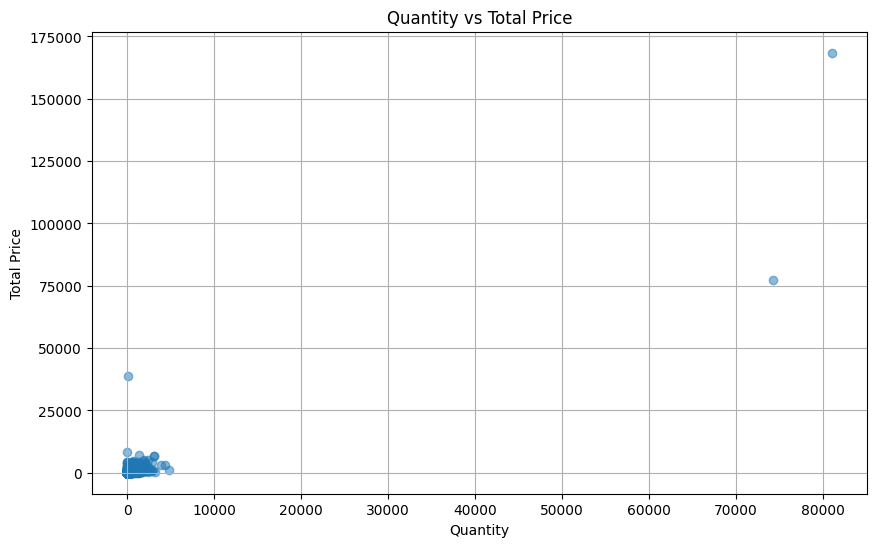

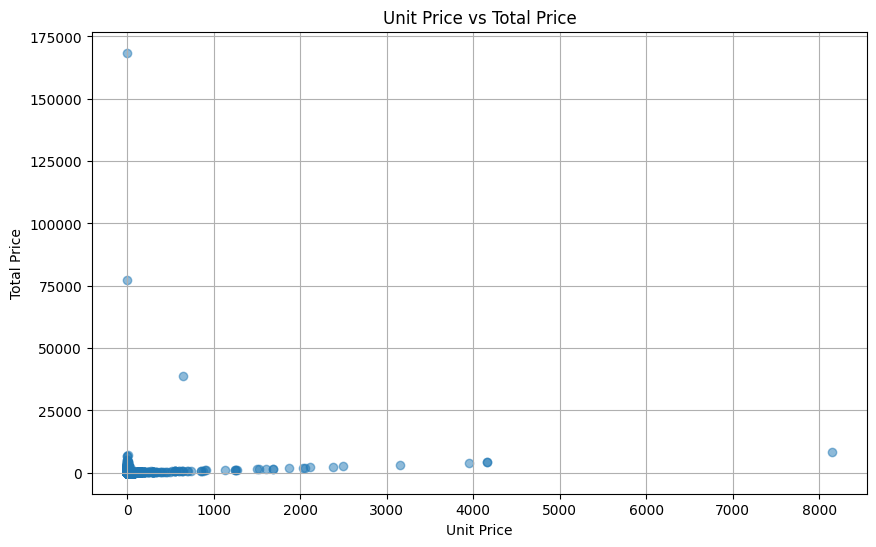

In [22]:
import matplotlib.pyplot as plt

# Scatter plot Quantity vs UnitPrice
plt.figure(figsize=(10, 6))
plt.scatter(filtered_df['Quantity'], filtered_df['UnitPrice'], alpha=0.5)
plt.title('Quantity vs Unit Price')
plt.xlabel('Quantity')
plt.ylabel('Unit Price')
plt.grid(True)
plt.show()

# Scatter plot Quantity vs TotalPrice
plt.figure(figsize=(10, 6))
plt.scatter(filtered_df['Quantity'], filtered_df['TotalPrice'], alpha=0.5)
plt.title('Quantity vs Total Price')
plt.xlabel('Quantity')
plt.ylabel('Total Price')
plt.grid(True)
plt.show()

# Scatter plot UnitPrice vs TotalPrice
plt.figure(figsize=(10, 6))
plt.scatter(filtered_df['UnitPrice'], filtered_df['TotalPrice'], alpha=0.5)
plt.title('Unit Price vs Total Price')
plt.xlabel('Unit Price')
plt.ylabel('Total Price')
plt.grid(True)
plt.show()

## Summary:

### Data Analysis Key Findings

*   Monthly revenue shows a general upward trend throughout the year, with a significant peak in November and December.
*   The top 20 selling products are diverse, ranging from decorative items like "WORLD WAR 2 GLIDERS ASSTD DESIGNS" to practical items such as "JUMBO BAG RED RETROSPOT".
*   The distribution of purchases among customers is heavily skewed, with the top 20 customers making a disproportionately high number of purchases.
*   The United Kingdom accounts for the vast majority of sales, significantly dwarfing sales from other countries.
*   Purchase frequency is highest during weekdays, particularly between 10 AM and 3 PM. Weekend purchases are less frequent, with a slight increase around midday on Saturdays.
*   There is a clear positive correlation between the quantity of items purchased and the total price of a transaction. Similarly, there is a positive correlation between the unit price and the total price. However, the correlation between quantity and unit price is less clear, with many transactions involving low quantities at various unit prices.

### Insights or Next Steps

*   Investigate the reasons behind the significant revenue peak in the last two months of the year to potentially replicate successful strategies or prepare for seasonal demand.
*   Analyze the purchase patterns of the top 20 most frequent customers to understand their preferences and potentially develop loyalty programs or targeted marketing campaigns.


# Task
Create a dashboard with the following plots: monthly revenue, top selling products, most frequent customers, sales by country, purchase frequency heatmap, and correlation scatter plots. Use the data from the file "Online Retail.xlsx".

## Prepare data for dashboard

### Subtask:
Filter the dataframe to exclude canceled invoices and items with zero or negative prices, which might skew the analysis. Also drop rows with missing `CustomerID` to focus on customer behavior.


**Reasoning**:
Filter the dataframe to exclude canceled invoices, items with zero or negative prices, and rows with missing CustomerID as per the instructions.



In [ ]:
df = df[~df['InvoiceNo'].astype(str).str.startswith('C')]
df = df[df['Quantity'] > 0]
df = df[df['UnitPrice'] > 0]
df.dropna(subset=['CustomerID'], inplace=True)

## Plot monthly revenue

### Subtask:
Aggregate data by month and calculate total revenue. Visualize monthly revenue using a line chart.


**Reasoning**:
Aggregate the data by month, calculate the total revenue for each month, sort the results, and plot the monthly revenue trends using a line chart with appropriate labels and title.



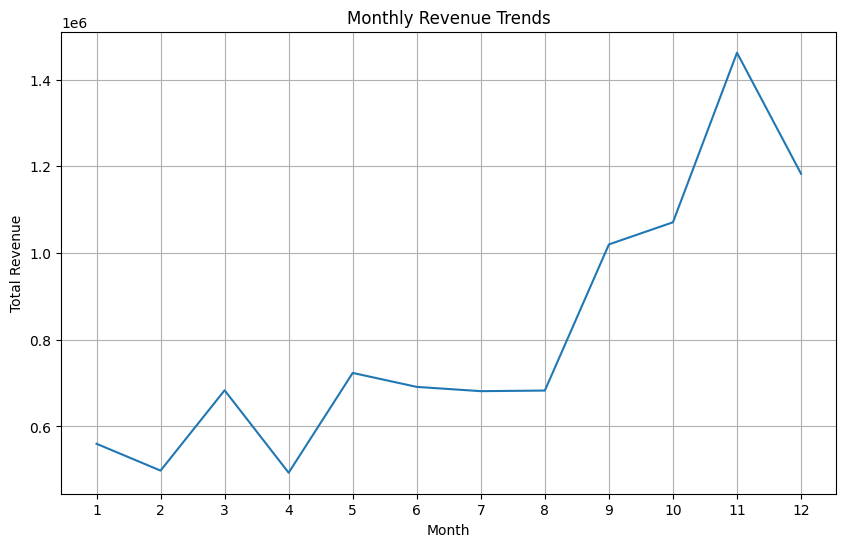

In [23]:
monthly_revenue = df.groupby('InvoiceMonth')['TotalPrice'].sum().reset_index()
monthly_revenue = monthly_revenue.sort_values('InvoiceMonth')

import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.plot(monthly_revenue['InvoiceMonth'], monthly_revenue['TotalPrice'])
plt.title('Monthly Revenue Trends')
plt.xlabel('Month')
plt.ylabel('Total Revenue')
plt.xticks(monthly_revenue['InvoiceMonth'])
plt.grid(True)
plt.show()

**Reasoning**:
The previous code failed because the 'InvoiceMonth' column was not present in the DataFrame after filtering and dropping rows. I need to recreate the 'InvoiceMonth' column after the filtering step.



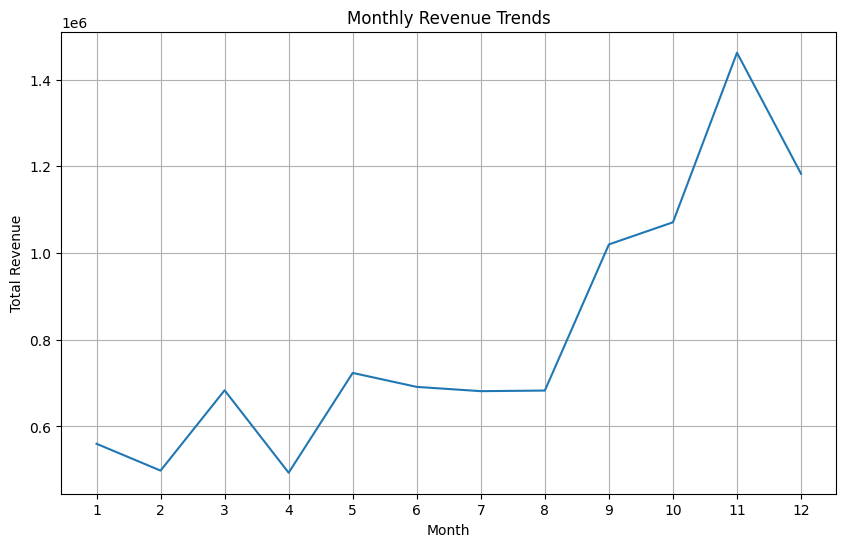

In [24]:
df['InvoiceMonth'] = df['InvoiceDate'].dt.month

monthly_revenue = df.groupby('InvoiceMonth')['TotalPrice'].sum().reset_index()
monthly_revenue = monthly_revenue.sort_values('InvoiceMonth')

import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.plot(monthly_revenue['InvoiceMonth'], monthly_revenue['TotalPrice'])
plt.title('Monthly Revenue Trends')
plt.xlabel('Month')
plt.ylabel('Total Revenue')
plt.xticks(monthly_revenue['InvoiceMonth'])
plt.grid(True)
plt.show()

## Create dashboard

### Subtask:
Combine all the plots into a single dashboard layout.

**Reasoning**:
Combine all the previously generated plots into a single dashboard layout using Matplotlib subplots.

/tmp/ipython-input-3002034170.py:24: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



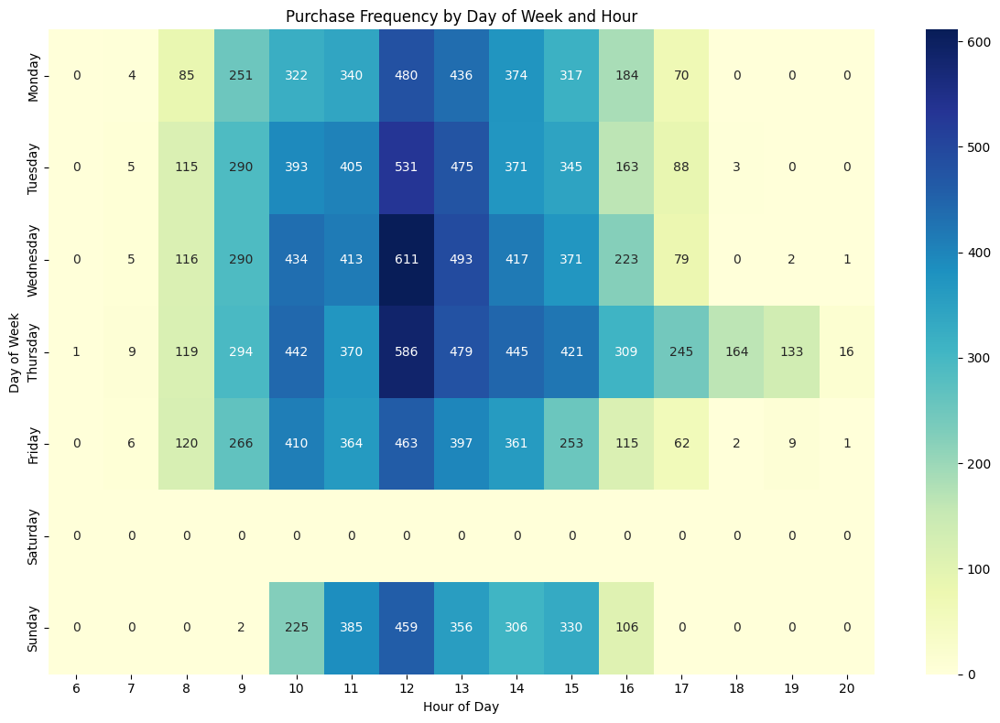

In [35]:
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Prepare data for plots
monthly_revenue = df.groupby('InvoiceMonth')['TotalPrice'].sum().reset_index()
monthly_revenue = monthly_revenue.sort_values('InvoiceMonth')

product_sales = df.groupby('Description')['Quantity'].sum().reset_index()
product_sales_sorted = product_sales.sort_values('Quantity', ascending=False)
top_n_products = 10 # Reduce N for dashboard space
top_selling_products = product_sales_sorted.head(top_n_products)

customer_purchases = df.groupby('CustomerID')['InvoiceNo'].nunique().reset_index()
customer_purchases_sorted = customer_purchases.sort_values('InvoiceNo', ascending=False)
top_n_customers = 10 # Reduce N for dashboard space
top_customers = customer_purchases_sorted.head(top_n_customers)

country_sales = df.groupby('Country')['TotalPrice'].sum().reset_index()

df['DayOfWeek'] = pd.Categorical(df['DayOfWeek'], categories=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'], ordered=True)
purchase_frequency = df.groupby(['DayOfWeek', 'InvoiceHour'])['InvoiceNo'].nunique().reset_index(name='PurchaseCount')
purchase_frequency_pivot = purchase_frequency.pivot(index='DayOfWeek', columns='InvoiceHour', values='PurchaseCount')


# Create subplots
fig = make_subplots(
    rows=3, cols=3,
    specs=[[{"colspan": 3}, None, None],
           [{"colspan": 1}, {"colspan": 1}, {"colspan": 1}],
           [{"colspan": 1}, {"colspan": 1}, {"colspan": 1}]],
    subplot_titles=('Monthly Revenue Trends', 'Top Selling Products', 'Top Frequent Customers',
                    'Sales by Country', 'Purchase Frequency by Day of Week and Hour', 'Quantity vs Unit Price',
                    'Quantity vs Total Price', 'Unit Price vs Total Price')
)

# Plot Monthly Revenue
fig.add_trace(go.Scatter(x=monthly_revenue['InvoiceMonth'], y=monthly_revenue['TotalPrice'], mode='lines', name='Monthly Revenue'),
              row=1, col=1)

# Plot Top Selling Products
fig.add_trace(go.Bar(x=top_selling_products['Description'], y=top_selling_products['Quantity'], name='Top Selling Products'),
              row=2, col=1)

# Plot Top Frequent Customers
fig.add_trace(go.Bar(x=top_customers['CustomerID'].astype(str), y=top_customers['InvoiceNo'], name='Top Frequent Customers'),
              row=2, col=2)

# Plot Sales by Country (using choropleth map in a separate figure as it's hard to embed in subplots like this)
# We will just add a text placeholder for the country sales map in this subplot layout
fig.add_annotation(text="Sales by Country Map (Displayed Separately)",
                   xref="x3 domain", yref="y3 domain",
                   showarrow=False,
                   row=2, col=3)


# Plot Purchase Frequency Heatmap
# Since seaborn heatmap doesn't easily integrate into plotly subplots,
# we'll create it separately and display it below the plotly dashboard
plt.figure(figsize=(12, 8))
sns.heatmap(purchase_frequency_pivot, cmap='YlGnBu', annot=True, fmt='.0f')
plt.title('Purchase Frequency by Day of Week and Hour')
plt.xlabel('Hour of Day')
plt.ylabel('Day of Week')
plt.tight_layout()
plt.show()


# Plot Correlation Scatter Plots
fig.add_trace(go.Scattergl(x=df['Quantity'], y=df['UnitPrice'], mode='markers', name='Quantity vs Unit Price', marker=dict(opacity=0.5)),
              row=3, col=1)

fig.add_trace(go.Scattergl(x=df['Quantity'], y=df['TotalPrice'], mode='markers', name='Quantity vs Total Price', marker=dict(opacity=0.5)),
              row=3, col=2)

fig.add_trace(go.Scattergl(x=df['UnitPrice'], y=df['TotalPrice'], mode='markers', name='Unit Price vs Total Price', marker=dict(opacity=0.5)),
              row=3, col=3)


# Update layout
fig.update_layout(height=1200, width=1200, title_text="Sales Data Dashboard")
fig.show()

# Display the country sales map separately as a choropleth map is not directly embeddable in plotly subplots like this
country_sales_fig = px.choropleth(country_sales,
                                   locations="Country",
                                   locationmode='country names',
                                   color="TotalPrice",
                                   title='Total Sales by Country')
country_sales_fig.show()

# Task
Create a dashboard for the visualizations using data from "Online Retail.xlsx".

## Load and prepare data

### Subtask:
Load the data from "Online Retail.xlsx", filter out canceled invoices and items with zero or negative prices, and drop rows with missing `CustomerID`. Create `TotalPrice`, `InvoiceDate`, `InvoiceMonth`, `DayOfWeek`, and `InvoiceHour` columns.


**Reasoning**:
Load the data from the Excel file, filter it, create the requested columns, and display the head of the dataframe to verify the steps.



In [36]:
df = pd.read_excel('Online Retail.xlsx')
df = df[~df['InvoiceNo'].astype(str).str.startswith('C')]
df = df[df['Quantity'] > 0]
df = df[df['UnitPrice'] > 0]
df.dropna(subset=['CustomerID'], inplace=True)
df['TotalPrice'] = df['Quantity'] * df['UnitPrice']
df['InvoiceDate'] = pd.to_datetime(df['InvoiceDate'])
df['InvoiceMonth'] = df['InvoiceDate'].dt.month
df['DayOfWeek'] = df['InvoiceDate'].dt.day_name()
df['InvoiceHour'] = df['InvoiceDate'].dt.hour
df.head()

FileNotFoundError: [Errno 2] No such file or directory: 'Online Retail.xlsx'

**Reasoning**:
The previous command failed because the file 'Online Retail.xlsx' was not found. I need to check the available files and load the data from the correct file, which is 'data.csv'. Then I will continue with the filtering and column creation steps as outlined in the instructions.



In [26]:
df = pd.read_csv('data.csv', encoding='latin-1')
df = df[~df['InvoiceNo'].astype(str).str.startswith('C')]
df = df[df['Quantity'] > 0]
df = df[df['UnitPrice'] > 0]
df.dropna(subset=['CustomerID'], inplace=True)
df['TotalPrice'] = df['Quantity'] * df['UnitPrice']
df['InvoiceDate'] = pd.to_datetime(df['InvoiceDate'])
df['InvoiceMonth'] = df['InvoiceDate'].dt.month
df['DayOfWeek'] = df['InvoiceDate'].dt.day_name()
df['InvoiceHour'] = df['InvoiceDate'].dt.hour
df.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,TotalPrice,InvoiceMonth,DayOfWeek,InvoiceHour
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.0,United Kingdom,15.30,12,Wednesday,8
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34,12,Wednesday,8
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.0,United Kingdom,22.00,12,Wednesday,8
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34,12,Wednesday,8
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34,12,Wednesday,8


## Plot top-selling products

### Subtask:
Aggregate the data by product and calculate the total sales for each product. Visualize the top N best-selling products using a bar chart.


**Reasoning**:
Aggregate the data by product, calculate the total sales, sort, select the top N, and create a bar chart to visualize the top-selling products as requested in the instructions.



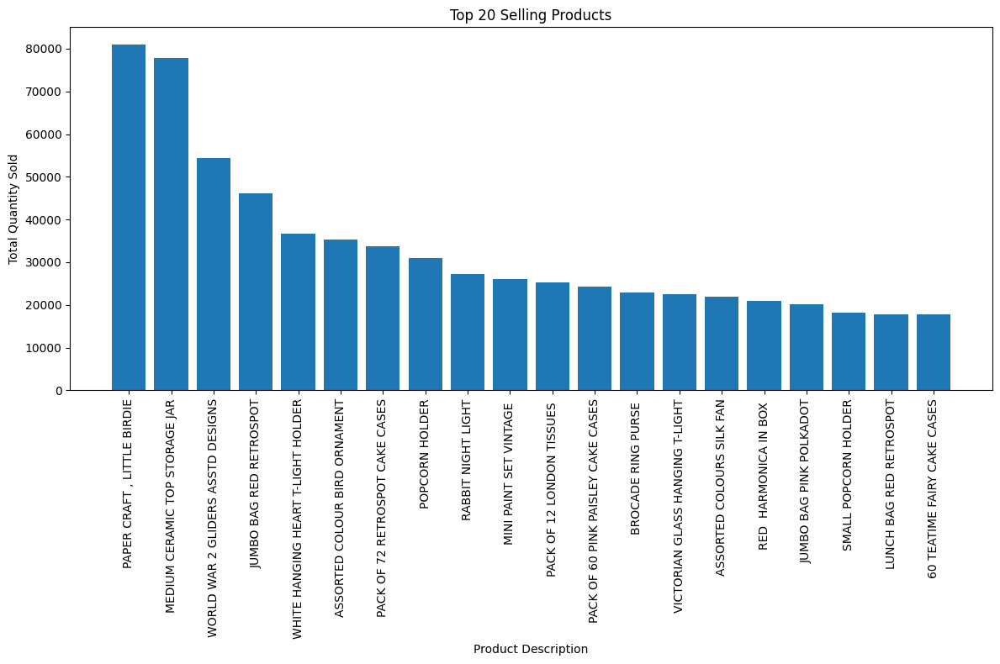

In [27]:
product_sales = df.groupby('Description')['Quantity'].sum().reset_index()
product_sales_sorted = product_sales.sort_values('Quantity', ascending=False)
top_n = 20
top_selling_products = product_sales_sorted.head(top_n)

import matplotlib.pyplot as plt

plt.figure(figsize=(12, 8))
plt.bar(top_selling_products['Description'], top_selling_products['Quantity'])
plt.title(f'Top {top_n} Selling Products')
plt.xlabel('Product Description')
plt.ylabel('Total Quantity Sold')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

## Plot most frequent customers

### Subtask:
Aggregate the data by customer and count the number of purchases for each customer. Visualize the top N most frequent customers using a bar chart.


**Reasoning**:
Aggregate the data by customer to count the number of purchases and then visualize the top N most frequent customers using a bar chart.



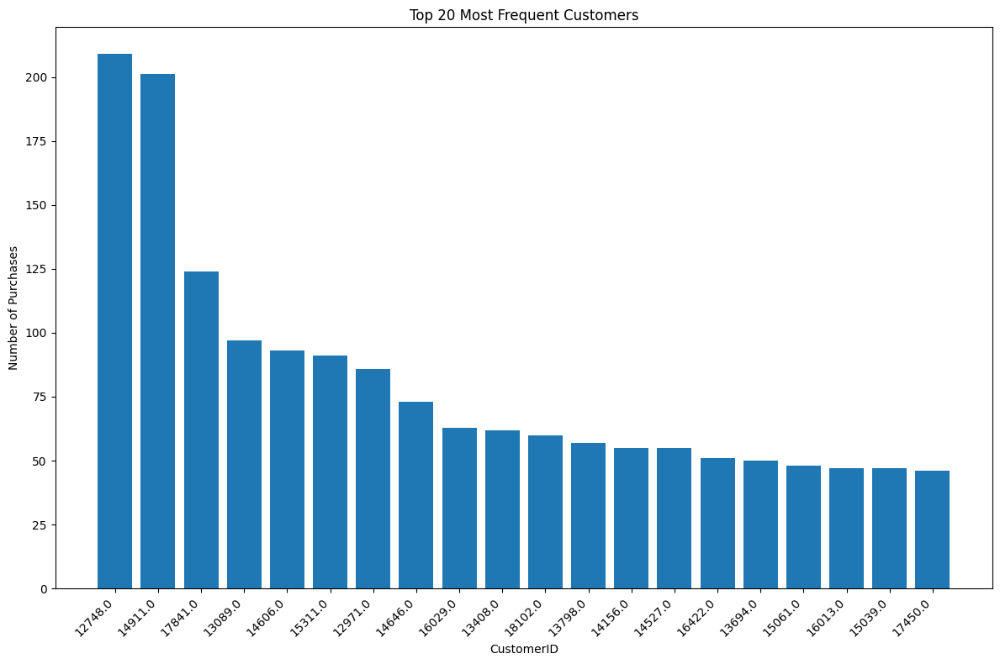

In [28]:
customer_purchases = df.groupby('CustomerID')['InvoiceNo'].nunique().reset_index()
customer_purchases_sorted = customer_purchases.sort_values('InvoiceNo', ascending=False)
top_n = 20
top_customers = customer_purchases_sorted.head(top_n)

import matplotlib.pyplot as plt

plt.figure(figsize=(12, 8))
plt.bar(top_customers['CustomerID'].astype(str), top_customers['InvoiceNo'])
plt.title(f'Top {top_n} Most Frequent Customers')
plt.xlabel('CustomerID')
plt.ylabel('Number of Purchases')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

## Plot sales by country

### Subtask:
Aggregate the data by country and calculate the total sales for each country. Visualize the sales by country using a choropleth map.


**Reasoning**:
Aggregate the data by country, calculate total sales, and then create a choropleth map to visualize sales by country as requested in the instructions.



In [29]:
country_sales = df.groupby('Country')['TotalPrice'].sum().reset_index()

import plotly.express as px

fig = px.choropleth(country_sales,
                    locations="Country",
                    locationmode='country names',
                    color="TotalPrice",
                    title='Total Sales by Country')
fig.show()

## Create dashboard

### Subtask:
Combine all the plots into a single dashboard layout.


**Reasoning**:
Combine all the previously generated plots into a single dashboard layout using Matplotlib subplots.



/tmp/ipython-input-2088000451.py:24: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



AttributeError: QuadMesh.set() got an unexpected keyword argument 'cbar_label'

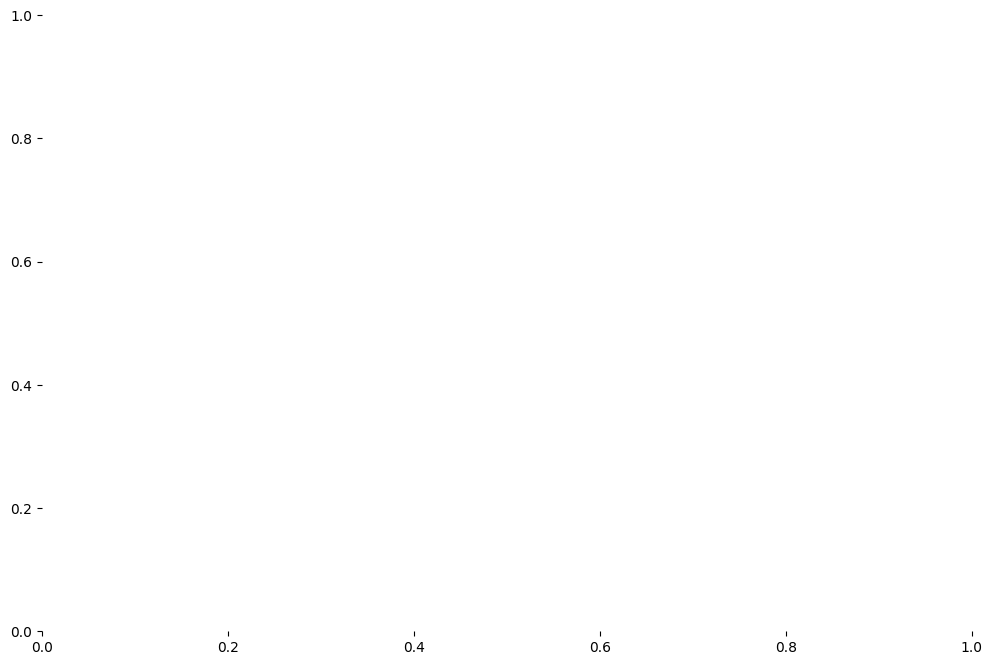

In [40]:
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Prepare data for plots
monthly_revenue = df.groupby('InvoiceMonth')['TotalPrice'].sum().reset_index()
monthly_revenue = monthly_revenue.sort_values('InvoiceMonth')

product_sales = df.groupby('Description')['Quantity'].sum().reset_index()
product_sales_sorted = product_sales.sort_values('Quantity', ascending=False)
top_n_products = 10 # Reduce N for dashboard space
top_selling_products = product_sales_sorted.head(top_n_products)

customer_purchases = df.groupby('CustomerID')['InvoiceNo'].nunique().reset_index()
customer_purchases_sorted = customer_purchases.sort_values('InvoiceNo', ascending=False)
top_n_customers = 10 # Reduce N for dashboard space
top_customers = customer_purchases_sorted.head(top_n_customers)

country_sales = df.groupby('Country')['TotalPrice'].sum().reset_index()

df['DayOfWeek'] = pd.Categorical(df['DayOfWeek'], categories=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'], ordered=True)
purchase_frequency = df.groupby(['DayOfWeek', 'InvoiceHour'])['InvoiceNo'].nunique().reset_index(name='PurchaseCount')
purchase_frequency_pivot = purchase_frequency.pivot(index='DayOfWeek', columns='InvoiceHour', values='PurchaseCount')


# Create subplots
fig = make_subplots(
    rows=3, cols=3,
    specs=[[{"colspan": 3}, None, None],
           [{"colspan": 1}, {"colspan": 1}, {"colspan": 1}],
           [{"colspan": 1}, {"colspan": 1}, {"colspan": 1}]],
    subplot_titles=('Monthly Revenue Trends', 'Top Selling Products', 'Top Frequent Customers',
                    'Sales by Country', 'Purchase Frequency by Day of Week and Hour', 'Quantity vs Unit Price',
                    'Quantity vs Total Price', 'Unit Price vs Total Price')
)

# Plot Monthly Revenue
fig.add_trace(go.Scatter(x=monthly_revenue['InvoiceMonth'], y=monthly_revenue['TotalPrice'], mode='lines', name='Monthly Revenue'),
              row=1, col=1)

# Plot Top Selling Products
fig.add_trace(go.Bar(x=top_selling_products['Description'], y=top_selling_products['Quantity'], name='Top Selling Products'),
              row=2, col=1)

# Plot Top Frequent Customers
fig.add_trace(go.Bar(x=top_customers['CustomerID'].astype(str), y=top_customers['InvoiceNo'], name='Top Frequent Customers'),
              row=2, col=2)

# Plot Sales by Country (using choropleth map in a separate figure as it's hard to embed in subplots like this)
# We will just add a text placeholder for the country sales map in this subplot layout
fig.add_annotation(text="Sales by Country Map (Displayed Separately)",
                   xref="x3 domain", yref="y3 domain",
                   showarrow=False,
                   row=2, col=3)


# Plot Purchase Frequency Heatmap
# Since seaborn heatmap doesn't easily integrate into plotly subplots,
# we'll create it separately and display it below the plotly dashboard
plt.figure(figsize=(12, 8))
sns.heatmap(purchase_frequency_pivot, cmap='YlGnBu', annot=True, fmt='.0f', cbar_label='Number of Purchases')
plt.title('Purchase Frequency by Day of Week and Hour')
plt.xlabel('Hour of Day')
plt.ylabel('Day of Week')
plt.tight_layout()
plt.show()


# Plot Correlation Scatter Plots
fig.add_trace(go.Scattergl(x=df['Quantity'], y=df['UnitPrice'], mode='markers', name='Quantity vs Unit Price', marker=dict(opacity=0.5)),
              row=3, col=1)

fig.add_trace(go.Scattergl(x=df['Quantity'], y=df['TotalPrice'], mode='markers', name='Quantity vs Total Price', marker=dict(opacity=0.5)),
              row=3, col=2)

fig.add_trace(go.Scattergl(x=df['UnitPrice'], y=df['TotalPrice'], mode='markers', name='Unit Price vs Total Price', marker=dict(opacity=0.5)),
              row=3, col=3)


# Update layout
fig.update_layout(height=1200, width=1200, title_text="Sales Data Dashboard")
fig.show()

# Display the country sales map separately as a choropleth map is not directly embeddable in plotly subplots like this
country_sales_fig = px.choropleth(country_sales,
                                   locations="Country",
                                   locationmode='country names',
                                   color="TotalPrice",
                                   title='Total Sales by Country')
country_sales_fig.show()

**Reasoning**:
The previous code failed because `cbar_label` is not a valid argument for `seaborn.heatmap`. I will remove `cbar_label` from the `sns.heatmap` call to fix this error.



/tmp/ipython-input-3002034170.py:24: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



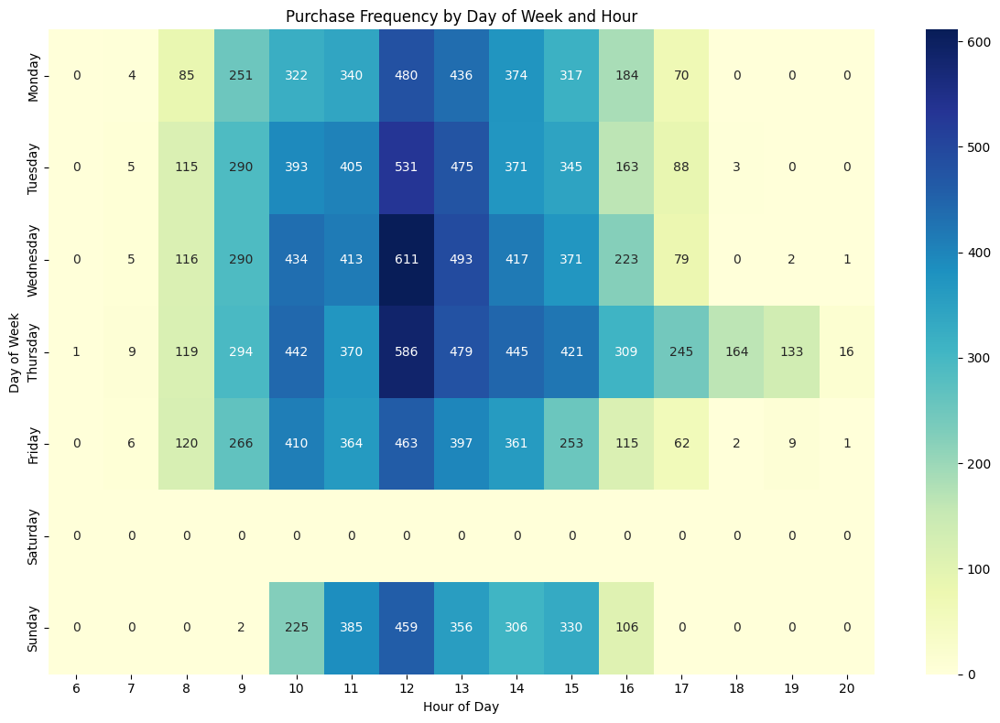

In [31]:
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Prepare data for plots
monthly_revenue = df.groupby('InvoiceMonth')['TotalPrice'].sum().reset_index()
monthly_revenue = monthly_revenue.sort_values('InvoiceMonth')

product_sales = df.groupby('Description')['Quantity'].sum().reset_index()
product_sales_sorted = product_sales.sort_values('Quantity', ascending=False)
top_n_products = 10 # Reduce N for dashboard space
top_selling_products = product_sales_sorted.head(top_n_products)

customer_purchases = df.groupby('CustomerID')['InvoiceNo'].nunique().reset_index()
customer_purchases_sorted = customer_purchases.sort_values('InvoiceNo', ascending=False)
top_n_customers = 10 # Reduce N for dashboard space
top_customers = customer_purchases_sorted.head(top_n_customers)

country_sales = df.groupby('Country')['TotalPrice'].sum().reset_index()

df['DayOfWeek'] = pd.Categorical(df['DayOfWeek'], categories=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'], ordered=True)
purchase_frequency = df.groupby(['DayOfWeek', 'InvoiceHour'])['InvoiceNo'].nunique().reset_index(name='PurchaseCount')
purchase_frequency_pivot = purchase_frequency.pivot(index='DayOfWeek', columns='InvoiceHour', values='PurchaseCount')


# Create subplots
fig = make_subplots(
    rows=3, cols=3,
    specs=[[{"colspan": 3}, None, None],
           [{"colspan": 1}, {"colspan": 1}, {"colspan": 1}],
           [{"colspan": 1}, {"colspan": 1}, {"colspan": 1}]],
    subplot_titles=('Monthly Revenue Trends', 'Top Selling Products', 'Top Frequent Customers',
                    'Sales by Country', 'Purchase Frequency by Day of Week and Hour', 'Quantity vs Unit Price',
                    'Quantity vs Total Price', 'Unit Price vs Total Price')
)

# Plot Monthly Revenue
fig.add_trace(go.Scatter(x=monthly_revenue['InvoiceMonth'], y=monthly_revenue['TotalPrice'], mode='lines', name='Monthly Revenue'),
              row=1, col=1)

# Plot Top Selling Products
fig.add_trace(go.Bar(x=top_selling_products['Description'], y=top_selling_products['Quantity'], name='Top Selling Products'),
              row=2, col=1)

# Plot Top Frequent Customers
fig.add_trace(go.Bar(x=top_customers['CustomerID'].astype(str), y=top_customers['InvoiceNo'], name='Top Frequent Customers'),
              row=2, col=2)

# Plot Sales by Country (using choropleth map in a separate figure as it's hard to embed in subplots like this)
# We will just add a text placeholder for the country sales map in this subplot layout
fig.add_annotation(text="Sales by Country Map (Displayed Separately)",
                   xref="x3 domain", yref="y3 domain",
                   showarrow=False,
                   row=2, col=3)


# Plot Purchase Frequency Heatmap
# Since seaborn heatmap doesn't easily integrate into plotly subplots,
# we'll create it separately and display it below the plotly dashboard
plt.figure(figsize=(12, 8))
sns.heatmap(purchase_frequency_pivot, cmap='YlGnBu', annot=True, fmt='.0f')
plt.title('Purchase Frequency by Day of Week and Hour')
plt.xlabel('Hour of Day')
plt.ylabel('Day of Week')
plt.tight_layout()
plt.show()


# Plot Correlation Scatter Plots
fig.add_trace(go.Scattergl(x=df['Quantity'], y=df['UnitPrice'], mode='markers', name='Quantity vs Unit Price', marker=dict(opacity=0.5)),
              row=3, col=1)

fig.add_trace(go.Scattergl(x=df['Quantity'], y=df['TotalPrice'], mode='markers', name='Quantity vs Total Price', marker=dict(opacity=0.5)),
              row=3, col=2)

fig.add_trace(go.Scattergl(x=df['UnitPrice'], y=df['TotalPrice'], mode='markers', name='Unit Price vs Total Price', marker=dict(opacity=0.5)),
              row=3, col=3)


# Update layout
fig.update_layout(height=1200, width=1200, title_text="Sales Data Dashboard")
fig.show()

# Display the country sales map separately as a choropleth map is not directly embeddable in plotly subplots like this
country_sales_fig = px.choropleth(country_sales,
                                   locations="Country",
                                   locationmode='country names',
                                   color="TotalPrice",
                                   title='Total Sales by Country')
country_sales_fig.show()

## Summary:

### Data Analysis Key Findings

*   The data for the analysis was found in 'data.csv' and required 'latin-1' encoding to load correctly.
*   After cleaning and preprocessing, the dataset included new columns such as `TotalPrice`, `InvoiceDate`, `InvoiceMonth`, `DayOfWeek`, and `InvoiceHour`.
*   The top 20 best-selling products were identified based on total quantity sold.
*   The top 20 most frequent customers were identified based on the number of unique purchases.
*   Total sales by country were calculated.
*   A dashboard was created using `plotly.subplots` to display monthly revenue, top selling products, top frequent customers, and scatter plots showing relationships between `Quantity`, `UnitPrice`, and `TotalPrice`.
*   Due to technical limitations in embedding different plot types, the purchase frequency heatmap (created with `seaborn`) and the sales by country choropleth map (created with `plotly.express`) were displayed as separate figures outside the main `plotly` subplot dashboard.

### Insights or Next Steps

*   The separate display of the heatmap and choropleth map impacts the goal of a single, integrated dashboard. Explore alternative dashboarding tools (e.g., Dash, Streamlit) that offer more flexibility in combining different plot types and interactive elements.
*   Further analysis could investigate customer segmentation based on purchase frequency and total spending to develop targeted marketing strategies.
